In [1]:
import numpy as np 
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly as py
import plotly.express as px
import plotly.graph_objs as go
from plotly.subplots import make_subplots
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=True) 

import warnings
warnings.filterwarnings('ignore')

In [2]:
#--- .css file above ---
#  Reference: 
#      - I really liked the way JohnM's punt kaggle submission had the headers, very aesthetically pleasing
#        and aids viewing - borrowing his div.h header concept (so much nicer looking than using conventional
#        ## headers etc), and adding a 'cayman' color theme to it, as a nod to R ...  
#        Isn't it nice looking ?  ->  https://jasonlong.github.io/cayman-theme/
#       
# -%%HTML
# <style type="text/css">
#
# div.h2 {
#     background-color: steelblue; 
#     color: white; 
#     padding: 8px; 
#     padding-right: 300px; 
#     font-size: 20px; 
#     max-width: 1500px; 
#     margin: auto; 
#     margin-top: 50px;
# }
# etc
# etc
# --- end reference ---
#
#--- Big Boys ---
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import matplotlib.patches as patches
import seaborn as sns
#--- Comp ---
# from kaggle.competitions import nflrush
#--- Plotly ---
import plotly as py
import plotly.express as px
import plotly.graph_objs as go
from plotly.subplots import make_subplots
from plotly.offline import download_plotlyjs
from plotly.offline import init_notebook_mode
from plotly.offline import plot,iplot
#--- Initial mode ---
#init_notebook_mode(connected=True) 
#--- Warnings ---
import warnings
warnings.filterwarnings('ignore')
#--- HTML ---
from IPython.display import HTML
from IPython.display import Image
from IPython.display import display
from IPython.core.display import display
from IPython.core.display import HTML
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"
from PIL import Image
#--- Styles ---
pd.set_option('display.max_columns', None)
plt.style.use('seaborn') 
color_pal = [x['color'] for x in plt.rcParams['axes.prop_cycle']]
##%config InlineBackend.figure_format = 'retina'   < - keep 
%config InlineBackend.figure_format = 'svg' 
#
th_props = [('font-size', '13px'), ('background-color', 'white'), ('color', '#666666')]
td_props = [('font-size', '15px'), ('background-color', 'white')]
styles = [dict(selector="td", props=td_props), dict(selector="th", props=th_props)]
###?sns.set_context('paper')  #Everything is smaller, use ? 
SMALL_SIZE = 8
MEDIUM_SIZE = 10
BIGGER_SIZE = 12
plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=SMALL_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=MEDIUM_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title
##This helps set size of all fontssns.set(font_scale=1.5)
#--- ML ---
from sklearn import preprocessing
from sklearn.model_selection import KFold
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import KFold
from sklearn.feature_selection import SelectFromModel
import gc, pickle, tqdm, os, datetime
#--- Import raw data ---
#
#Import
df = pd.read_csv('train.csv', low_memory=False)
gold = pd.read_csv('train.csv', low_memory=False)
dontbreak = pd.read_csv('train.csv', low_memory=False)
#
#
##base = df[df["NflIdRusher == NflId"]]
##killed_kolumns = ["GameId","PlayId","Team","Yards","TimeHandoff","TimeSnap"]
#ingplus.com/plots/top-50-matplotlib-visualizations-the-master-plots-python#
#NOTES:
#          sns.despine(bottom=True, left=True)
#  ax.set_title("Rankings Given by Wine Magazine", fontsize=20)

# df04 = tf.groupby('PossessionTeam')['Yards'].agg(sum).sort_values(ascending=False)
# df04 = pd.DataFrame(df04)
# df04['Team'] = df04.index
# df04
#
#
#Some Links:
# Source:  http://www.ncaa.org/about/resources/research/estimated-probability-competing-professional-athletics
#
#

# sns.despine(left=True)

In [3]:
df_train = pd.read_csv('train.csv', low_memory=False)

In [4]:
rl = pd.DataFrame(df_train.columns)  #rl = recordlocator...
rl.columns=['Mapper']
rl

,Mapper
0,GameId
1,PlayId
2,Team
3,X
4,Y
5,S
6,A
7,Dis
8,Orientation
9,Dir


In [5]:
df_train.head()

,GameId,PlayId,Team,X,Y,S,A,Dis,Orientation,Dir,NflId,DisplayName,JerseyNumber,Season,YardLine,Quarter,GameClock,PossessionTeam,Down,Distance,FieldPosition,HomeScoreBeforePlay,VisitorScoreBeforePlay,NflIdRusher,OffenseFormation,OffensePersonnel,DefendersInTheBox,DefensePersonnel,PlayDirection,TimeHandoff,TimeSnap,Yards,PlayerHeight,PlayerWeight,PlayerBirthDate,PlayerCollegeName,Position,HomeTeamAbbr,VisitorTeamAbbr,Week,Stadium,Location,StadiumType,Turf,GameWeather,Temperature,Humidity,WindSpeed,WindDirection
0,2017090700,20170907000118,away,73.91,34.84,1.69,1.13,0.40,81.99,177.18,496723,Eric Berry,29,2017,35,1,14:14:00,NE,3,2,NE,0,0,2543773,SHOTGUN,"1 RB, 1 TE, 3 WR",6.0,"2 DL, 3 LB, 6 DB",left,2017-09-08T00:44:06.000Z,2017-09-08T00:44:05.000Z,8,6-0,212,12/29/1988,Tennessee,SS,NE,KC,1,Gillette Stadium,"Foxborough, MA",Outdoor,Field Turf,Clear and warm,63.0,77.0,8,SW
1,2017090700,20170907000118,away,74.67,32.64,0.42,1.35,0.01,27.61,198.70,2495116,Allen Bailey,97,2017,35,1,14:14:00,NE,3,2,NE,0,0,2543773,SHOTGUN,"1 RB, 1 TE, 3 WR",6.0,"2 DL, 3 LB, 6 DB",left,2017-09-08T00:44:06.000Z,2017-09-08T00:44:05.000Z,8,6-3,288,03/25/1989,Miami,DE,NE,KC,1,Gillette Stadium,"Foxborough, MA",Outdoor,Field Turf,Clear and warm,63.0,77.0,8,SW
2,2017090700,20170907000118,away,74.00,33.20,1.22,0.59,0.31,3.01,202.73,2495493,Justin Houston,50,2017,35,1,14:14:00,NE,3,2,NE,0,0,2543773,SHOTGUN,"1 RB, 1 TE, 3 WR",6.0,"2 DL, 3 LB, 6 DB",left,2017-09-08T00:44:06.000Z,2017-09-08T00:44:05.000Z,8,6-3,270,01/21/1989,Georgia,DE,NE,KC,1,Gillette Stadium,"Foxborough, MA",Outdoor,Field Turf,Clear and warm,63.0,77.0,8,SW
3,2017090700,20170907000118,away,71.46,27.70,0.42,0.54,0.02,359.77,105.64,2506353,Derrick Johnson,56,2017,35,1,14:14:00,NE,3,2,NE,0,0,2543773,SHOTGUN,"1 RB, 1 TE, 3 WR",6.0,"2 DL, 3 LB, 6 DB",left,2017-09-08T00:44:06.000Z,2017-09-08T00:44:05.000Z,8,6-3,245,11/22/1982,Texas,ILB,NE,KC,1,Gillette Stadium,"Foxborough, MA",Outdoor,Field Turf,Clear and warm,63.0,77.0,8,SW
4,2017090700,20170907000118,away,69.32,35.42,1.82,2.43,0.16,12.63,164.31,2530794,Ron Parker,38,2017,35,1,14:14:00,NE,3,2,NE,0,0,2543773,SHOTGUN,"1 RB, 1 TE, 3 WR",6.0,"2 DL, 3 LB, 6 DB",left,2017-09-08T00:44:06.000Z,2017-09-08T00:44:05.000Z,8,6-0,206,08/17/1987,Newberry,FS,NE,KC,1,Gillette Stadium,"Foxborough, MA",Outdoor,Field Turf,Clear and warm,63.0,77.0,8,SW


In [6]:
df_train.head(1).T

,0
GameId,2017090700
PlayId,20170907000118
Team,away
X,73.91
Y,34.84
S,1.69
A,1.13
Dis,0.4
Orientation,81.99
Dir,177.18


In [7]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 509762 entries, 0 to 509761
Data columns (total 49 columns):
GameId                    509762 non-null int64
PlayId                    509762 non-null int64
Team                      509762 non-null object
X                         509762 non-null float64
Y                         509762 non-null float64
S                         509762 non-null float64
A                         509762 non-null float64
Dis                       509762 non-null float64
Orientation               509744 non-null float64
Dir                       509748 non-null float64
NflId                     509762 non-null int64
DisplayName               509762 non-null object
JerseyNumber              509762 non-null int64
Season                    509762 non-null int64
YardLine                  509762 non-null int64
Quarter                   509762 non-null int64
GameClock                 509762 non-null object
PossessionTeam            509762 non-null object
Down   

Summary of our dataset:  
It is always important to look at our entire dataset and examine the descriptive statistics:  

  Number of football teams in the NFL:   32  
  Number of unique NFL players in our dataset:   2,231  
  Number of 2017 Season players:   1,788  
  Number of 2018 Season players:   1,783  
  Number of games a team plays in a NFL season:   16  
  Number of weeks in a NFL season:   17  
  Total unique NFL games played per season:   256  
  Number of NFL seasons in the dataset:   2  
  Dataset NFL season years:   2017 and 2018 Seasons  
  Dataset total number of unique NFL games:   512  
  Number of unique plays in our dataset:   23,171  
  Number of 2017 Season running plays:   11,900  
  Number of 2018 Season running plays:   11,271  
  Number of unique NFL jersey numbers:   99  
  Number of players on roster that never played:   11  
  Size of a typical NFL field (in acres):   1.32

In [8]:
#--- raw counts ---
print(len(df_train.Season.unique()))
print(len(df_train.NflId.unique()))
print(len(df_train.PlayId.unique()))
print(len(df_train[df_train.Season==2017].PlayId.unique()))
print(len(df_train[df_train.Season==2018].PlayId.unique()))

2
2231
23171
11900
11271


In [10]:
nullvalues = df_train.loc[:, df_train.isnull().any()].isnull().sum().sort_values(ascending=False)

print(nullvalues)

WindDirection        80234
WindSpeed            67430
Temperature          48532
GameWeather          43648
StadiumType          32934
FieldPosition         6424
Humidity              6160
OffenseFormation       110
DefendersInTheBox       66
Orientation             18
Dir                     14
dtype: int64


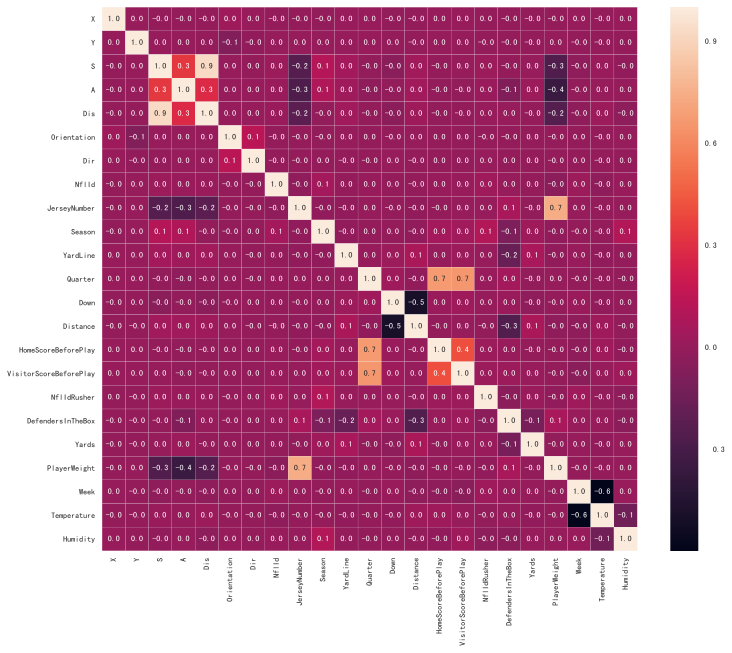

In [11]:
#i'll ignore to ids.
f,ax = plt.subplots(figsize=(12,10))
sns.heatmap(df_train.iloc[:,2:].corr(),annot=True, linewidths=.1, fmt='.1f', ax=ax)

plt.show()

The correlation in this heatmap is easy to understand.

In [12]:
unique_plays = df_train.groupby('Season').agg({'PlayId': 'nunique', 'GameId': 'nunique', 'NflId':'nunique'})
unique_plays.columns = ["PlayCount","GameCount", "PlayerCount"]

print(unique_plays)

        PlayCount  GameCount  PlayerCount
Season                                   
2017        11900        256         1788
2018        11271        256         1783


Text(0.5, 1.0, 'Count of Plays')

Text(0.5, 1.0, 'Count of Games')

Text(0.5, 1.0, 'Count of Player')

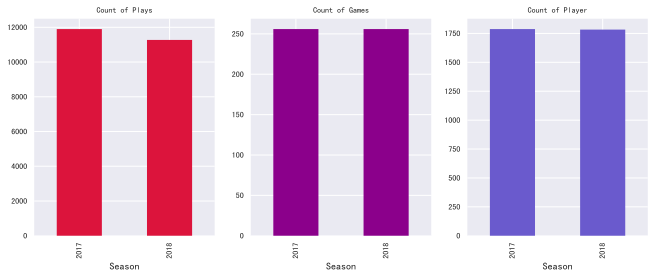

In [13]:
f,ax=plt.subplots(1,3,figsize=(11,4))
unique_plays["PlayCount"].plot(ax=ax[0],color='crimson', kind='bar')

ax[0].set_title('Count of Plays')
unique_plays["GameCount"].plot(ax=ax[1],color='darkmagenta', kind='bar')

ax[1].set_title('Count of Games')
unique_plays["PlayerCount"].plot(ax=ax[2],color='slateblue', kind='bar')

ax[2].set_title('Count of Player')

plt.show()

In [14]:
df_team = df_train.loc[:,['PlayId', 'Team']].drop_duplicates()
teamcount = df_team["Team"].value_counts()
df_teamcount = pd.DataFrame({'Team': teamcount.index, 'Count': teamcount.values})

fig = px.bar(df_teamcount, x='Team', y='Count')
fig.update_layout(
    title_text="Team (Away or Home)", height=300, width=300
)

fig.show()

In [15]:
teamcount

away    23171
home    23171
Name: Team, dtype: int64

In [16]:
df_player = df_train.loc[:,['NflId', 'DisplayName', 'PlayerBirthDate', 'PlayerWeight', 'PlayerHeight', 'PlayerCollegeName']].drop_duplicates()

df_player["HeightFt"] = df_player["PlayerHeight"].str.split('-', expand=True)[0].astype(int)
df_player["HeightIn"] = df_player["PlayerHeight"].str.split('-', expand=True)[1].astype(int)
df_player["HeightCm"] = df_player["HeightFt"]*30.48 + df_player["HeightIn"]*2.54

df_player["WeightKg"] = df_player["PlayerWeight"]*0.45359237

df_height = df_player.groupby(['PlayerHeight','HeightFt','HeightIn']).size().reset_index().sort_values(["HeightFt", "HeightIn"])

df_height.columns = ["PlayerHeight","HeightFt","HeightIn","Count"]

Text(0.5, 0, 'Height')

Text(0, 0.5, 'Count')

Text(0.5, 1.0, 'Player Height (ft-in)')

Text(0.5, 0, 'Weight')

Text(0.5, 1.0, 'Player Weight (lbs)')

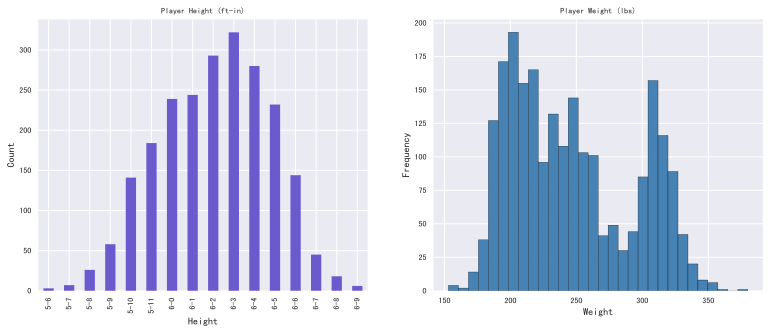

In [17]:
f,ax=plt.subplots(1,2,figsize=(13,5))
df_height.loc[:,["PlayerHeight","Count"]].set_index("PlayerHeight").plot(ax=ax[0],color='slateblue', kind='bar')

ax[0].set_xlabel("Height") 
ax[0].set_ylabel("Count") 
ax[0].get_legend().remove()
ax[0].set_title('Player Height (ft-in)')

df_player.PlayerWeight.plot.hist(ax=ax[1],bins=30,edgecolor='black',color='steelblue')

ax[1].set_xlabel("Weight") 
ax[1].set_title('Player Weight (lbs)')

plt.show()

In [18]:
fig = go.Figure(data=go.Scattergl
(
    x = df_player["HeightCm"], 
    y = df_player["WeightKg"],
    mode='markers',
    text = df_player['DisplayName'],
    marker=dict(line_width=0.4),
    marker_color='rgb(0,145,119)'
)
               )

fig.update_layout(title='Weight Height Correlation', height=600, width=800)
fig.update_xaxes(title_text="Height (Cm)")
fig.update_yaxes(title_text="Weight (Kg)")

fig.show()

In [19]:
Collage = df_player["PlayerCollegeName"].value_counts()
df_CollageCount = pd.DataFrame({'College Name':Collage.index, 'Count':Collage.values}).sort_values("Count", ascending = False).head(50)

fig = px.bar(df_CollageCount, x='College Name', y='Count', title="The 50 Top Colleges With The Most Players", height=700, width=800)

fig.update_traces(marker_color='rgb(239, 117, 100)', marker_line_color='rgb(8,48,107)',
                  marker_line_width=2, opacity=0.7
                 )
fig.show()

In [20]:
df_CollageCount

,College Name,Count
0,Alabama,58
1,Florida,45
2,Ohio State,43
3,Florida State,38
4,Georgia,36
6,Clemson,35
5,Penn State,35
7,Louisiana State,33
8,Michigan,33
9,Auburn,33


In [21]:
df_player['BirthDate'] = df_player['PlayerBirthDate'].astype('datetime64[ns]')

#df_train["TimeSnap"].astype('datetime64[ns]').sort_values(ascending=False)
#max date in TimeSnap cloumn is 2018-12-31, so i'm not using today function

df_player['MaxDate'] = pd.to_datetime('2018-12-31')

df_player['Age'] = round((df_player['MaxDate'] - df_player['BirthDate'])/np.timedelta64(1,'D')/365.25,1)

<Figure size 432x432 with 0 Axes>

(array([ 21.,  87., 236., 310., 304., 329., 225., 186., 169., 120.,  80.,
         60.,  42.,  26.,  23.,  11.,   4.,   4.,   3.,   2.]),
 array([20.7  , 21.735, 22.77 , 23.805, 24.84 , 25.875, 26.91 , 27.945,
        28.98 , 30.015, 31.05 , 32.085, 33.12 , 34.155, 35.19 , 36.225,
        37.26 , 38.295, 39.33 , 40.365, 41.4  ]),
 <a list of 20 Patch objects>)

Text(0.5, 1.0, 'Age of Players in 2018 Season')

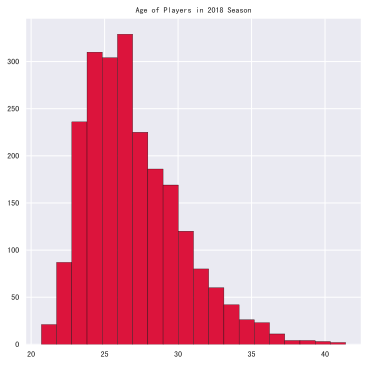

In [22]:
plt.figure(figsize=(6,6))

plt.hist(df_player["Age"], bins=20 ,edgecolor='black', color='crimson')
plt.title("Age of Players in 2018 Season")

plt.show()

In [23]:
df_stadium = df_train.loc[:,["PlayId","Stadium", "StadiumType"]].drop_duplicates()
stadium = df_stadium["Stadium"].value_counts()
# df_stadiumCount = pd.DataFrame({'Stadium':stadium.index, 'Count':stadium.values}).sort_values("Stadium")
df_stadiumCount = pd.DataFrame({'Stadium':stadium.index, 'Count':stadium.values}).sort_values("Count", ascending = False)
fig = px.bar(df_stadiumCount, x='Stadium', y='Count', title="Games by Stadium", height=700, width=800)

fig.update_traces(marker_color='darkorange', marker_line_color='rgb(8,48,107)',
                  marker_line_width=2, opacity=0.7
                 )

fig.show()

In [24]:
StadiumType = df_stadium["StadiumType"].value_counts()

# df_StadiumType = pd.DataFrame({'StadiumType':StadiumType.index, 'Count':StadiumType.values}).sort_values("StadiumType")
df_StadiumType = pd.DataFrame({'StadiumType':StadiumType.index, 'Count':StadiumType.values}).sort_values("Count", ascending = False)

fig = px.bar(df_StadiumType, x='StadiumType', y='Count', title="Games by Stadium Type", height=600, width=800)

fig.update_traces(marker_color='rgb(158,202,225)', marker_line_color='rgb(8,48,107)',
                  marker_line_width=1.5, opacity=0.6
                 )

fig.show()

Here we can see that the type can be combined. I believe that some of the describe at here are same.  
And another question:  
what's the porporation of the stadiums?

In [25]:
df_stadium_o = df_train.loc[:,["Stadium", "StadiumType"]].drop_duplicates()
stadium_o = df_stadium_o["Stadium"].value_counts()
# df_stadium_oCount = pd.DataFrame({'stadium_o':stadium_o.index, 'Count':stadium_o.values}).sort_values("stadium_o")
df_stadium_oCount = pd.DataFrame({'stadium_o':stadium_o.index, 'Count':stadium_o.values}).sort_values("Count", ascending = False)
fig = px.bar(df_stadium_oCount, x='stadium_o', y='Count', title="Games by stadium_o", height=700, width=800)

fig.update_traces(marker_color='darkorange', marker_line_color='rgb(8,48,107)',
                  marker_line_width=2, opacity=0.7
                 )

fig.show()

In [26]:
df_stadium_o[df_stadium_o['Stadium']=='Mercedes-Benz Stadium']

,Stadium,StadiumType
48818,Mercedes-Benz Stadium,"Domed, closed"
78782,Mercedes-Benz Stadium,"Indoor, Roof Closed"
145310,Mercedes-Benz Stadium,Closed Dome
167068,Mercedes-Benz Stadium,"Dome, closed"
336996,Mercedes-Benz Stadium,"Domed, Open"
363242,Mercedes-Benz Stadium,"Domed, open"


In [27]:
StadiumType_o = df_stadium_o["StadiumType"].value_counts()

# df_StadiumType = pd.DataFrame({'StadiumType':StadiumType.index, 'Count':StadiumType.values}).sort_values("StadiumType")
df_StadiumType_o = pd.DataFrame({'StadiumType':StadiumType_o.index, 'Count':StadiumType_o.values}).sort_values("Count", ascending = False)

fig = px.bar(df_StadiumType_o, x='StadiumType', y='Count', title="Count by Stadium Type", height=600, width=800)

fig.update_traces(marker_color='rgb(158,202,225)', marker_line_color='rgb(8,48,107)',
                  marker_line_width=1.5, opacity=0.6
                 )

fig.show()

In [28]:
stadium_loc = df_train.loc[:,['GameId', 'Location']].drop_duplicates()
stadium_loc = stadium_loc['Location'].value_counts()

df_stadium_loc = pd.DataFrame({'Location':stadium_loc.index, 'Count':stadium_loc.values})

df_stadium_loc["State"] = df_stadium_loc["Location"].str.split(', ', expand=True)[0]
df_stadium_loc["StateAbb"] = df_stadium_loc["Location"].str.split(', ', expand=True)[1]


fig = go.Figure(data=go.Choropleth(
    locations=df_stadium_loc["StateAbb"], 
    z = df_stadium_loc['Count'], 
    locationmode = 'USA-states', 
    text = df_stadium_loc['State'],
    colorscale=
            [[0.0, "rgb(251, 237, 235)"],
            [0.09, "rgb(245, 211, 206)"],
            [0.12, "rgb(239, 179, 171)"],
            [0.15, "rgb(236, 148, 136)"],
            [0.22, "rgb(239, 117, 100)"],
            [0.35, "rgb(235, 90, 70)"],
            [0.45, "rgb(207, 81, 61)"],
            [0.65, "rgb(176, 70, 50)"],
            [0.85, "rgb(147, 59, 39)"],
            [1.00, "rgb(110, 47, 26)"]],
    autocolorscale = False
)
               )

fig.update_layout(
    geo_scope='usa',
    title_text = 'Total Number of Games by States in 2017 and 2018', height=500, width=700  
)

fig.show()

In [29]:
# from the results here, we can know that the data is not clean, so the visualization is not accurate
df_stadium_loc

,Location,Count,State,StateAbb
0,"East Rutherford, NJ",29,East Rutherford,NJ
1,"Atlanta, GA",16,Atlanta,GA
2,"Landover, MD",16,Landover,MD
3,"Santa Clara, CA",16,Santa Clara,CA
4,"Nashville, TN",16,Nashville,TN
5,"Indianapolis, Ind.",16,Indianapolis,Ind.
6,"Denver, CO",16,Denver,CO
7,"Minneapolis, MN",16,Minneapolis,MN
8,"Tampa, FL",16,Tampa,FL
9,"Green Bay, WI",16,Green Bay,WI


In [30]:
df_Def = df_train.loc[:,["PlayId","DefensePersonnel"]].drop_duplicates()
DefenseCount = df_Def["DefensePersonnel"].value_counts()

dic_Defense = {'DL': [0],'LB': [0],'DB': [0],'OL': [0]}
df_Defense = pd.DataFrame.from_dict(dic_Defense, orient='index')
df_Defense.columns = ["Count"]

for i in DefenseCount.index:
    for j in i.split(", "):
        df_Defense.loc[ j.split(" ")[1] : j.split(" ")[1],:] += int(j.split(" ")[0]) * DefenseCount[i]

In [31]:
colors = ['gold', 'mediumturquoise', 'darkorange', 'lightgreen']

fig = go.Figure(data=[go.Pie(labels=df_Defense.index.values.tolist(), 
                             values=df_Defense["Count"].tolist())])
fig.update_traces(hoverinfo='label+percent', textinfo='value', textfont_size=18,
                  marker=dict(colors=colors, line=dict(color='#000000', width=2)))

fig.update_layout(
    title_text="Defensive Players Ratio in All Plays", height=500, width=700
)

fig.show()

In [32]:
df_Off = df_train.loc[:,["PlayId","OffensePersonnel"]].drop_duplicates()
df_Off["OffensePersonnel"] = df_Off["OffensePersonnel"].str.replace(",1", ", 1")
df_Off["OffensePersonnel"] = df_Off["OffensePersonnel"].str.replace(",2", ", 2")
OffenseCount = df_Off["OffensePersonnel"].value_counts()

dic_Offense = {'DL': [0],'LB': [0],'DB': [0],'OL': [0],'RB': [0],'TE': [0],'WR': [0],'QB': [0]}
df_Offense = pd.DataFrame.from_dict(dic_Offense, orient='index')
df_Offense.columns = ["Count"]

for i in OffenseCount.index:
    for j in i.split(", "):
        df_Offense.loc[ j.split(" ")[1] : j.split(" ")[1],:] += int(j.split(" ")[0]) * OffenseCount[i]

In [33]:
colors = ['g', 'b', 'p', 'plum', 'gold', 'mediumturquoise', 'darkorange', 'lightgreen']

fig = go.Figure(data=[go.Pie(labels=df_Offense.index.values.tolist(), 
                             values=df_Offense["Count"].tolist() , hole=.3)]
               )

fig.update_traces(hoverinfo='label+percent', textinfo='value', textfont_size=18,
                  marker=dict(colors=colors, line=dict(color='#000000', width=2))
                 )

fig.update_layout(
    title_text="Offensive Players Ratio in All Plays", height=500, width=700
)

fig.show()

In [34]:
df_speed = df_train.loc[:,['DisplayName', 'S']].groupby('DisplayName').mean()
df_speed.columns = ["Average Speed"]
df_speed = df_speed.sort_values("Average Speed", ascending = False)

In [35]:
fig = px.histogram(df_speed, x="Average Speed",
                   title='Average Speed Distribution of Players',
                   opacity=0.8,
                   color_discrete_sequence=['indianred']
                   )

fig.update_layout(
    yaxis_title_text='Count',
    xaxis_title_text='Average Speed   yards/second',
    height=500, width=800)

fig.update_traces(marker_line_color='rgb(8,48,107)',
                  marker_line_width=1.5, opacity=0.8
                 )

fig.show()

In [36]:
df_speed_yards = df_train[df_train["NflIdRusher"] == df_train["NflId"]].loc[:,['GameId', 'DisplayName', 'S', 'Yards']]


fig = go.Figure(data=go.Scattergl
(
    x = df_speed_yards["Yards"], 
    y = df_speed_yards["S"],
    text = df_speed_yards['DisplayName'],
    mode='markers',
    marker=dict(line_width=0.4),
    marker_color='darkorange'
)
               )

fig.update_layout(title='Speed to Yards', height=700, width=800)

fig.update_xaxes(title_text="Yards")
fig.update_yaxes(title_text="Speed (yards/second)")

fig.show()

In [37]:
df_avg_speed = df_speed_yards.groupby('DisplayName').agg({'S':'mean', 'Yards':'sum'})

fig = go.Figure(data=go.Scattergl
(
    x = df_avg_speed["Yards"], 
    y = df_avg_speed["S"],
    text = df_avg_speed.index,
    mode='markers',
    marker=dict(line_width=0.4),
    marker_color='darkorange'
)
               )

fig.update_layout(title='Avg Speed and total Yards', height=700, width=800)

fig.update_xaxes(title_text="total Yards")
fig.update_yaxes(title_text="Avg Speed (yards/second)")

fig.show()

In [38]:
df_MaxSpeed = df_train.loc[:,['DisplayName', 'PlayerBirthDate', 'TimeSnap', 'S', 'Orientation']].groupby(['DisplayName', 'PlayerBirthDate'], as_index=False).max()

df_MaxSpeed["Age"] = round((df_MaxSpeed['TimeSnap'].astype('datetime64[ns]') - df_MaxSpeed['PlayerBirthDate'].astype('datetime64[ns]'))/np.timedelta64(1,'D')/365.25,1)

In [39]:
fig = go.Figure(data=go.Scattergl
(
    x = df_MaxSpeed["S"], 
    y = df_MaxSpeed["Age"],
    text = df_MaxSpeed['DisplayName'],
    mode='markers',
    marker=dict(line_width=0.4),
    marker_color='mediumorchid'
)
               ) 

fig.update_layout(title='Age of The Players When They Make Their Maximum Speed', height=700, width=800)
fig.update_traces(marker_line_color='rgb(8,48,107)', opacity=0.7)

fig.update_xaxes(title_text="Speed of Player (yards/second)")
fig.update_yaxes(title_text="Age")

fig.show()

In [40]:
fig = go.Figure()

fig.add_trace(go.Scatter(x=df_MaxSpeed["S"], y=df_MaxSpeed["Orientation"],
                    mode='markers',
                    text = df_MaxSpeed['DisplayName'],     
                    name='Speed',
                    marker=dict(line_width=0.4)
                    )
             )

fig.add_trace(go.Scatter(x=df_MaxSpeed["Age"], y=df_MaxSpeed["Orientation"],
                    mode='markers',
                    text = df_MaxSpeed['DisplayName'],     
                    name='Age',
                    marker=dict(line_width=0.4)
                    )
             )

fig.update_layout(title='Orientation & Speed +  Orientation & Age Correlation', height=500, width=800)

fig.update_traces(marker_line_color='rgb(8,48,107)', opacity=0.8)

fig.update_yaxes(title_text="Orientation")

fig.show()

In [41]:
df_OffenseForm = df_train.loc[:,['PlayId', 'OffenseFormation', 'Season']].drop_duplicates()
OffenseForm2017 = df_OffenseForm[df_train["Season"] == 2017]["OffenseFormation"].value_counts()
OffenseForm2018 = df_OffenseForm[df_train["Season"] == 2018]["OffenseFormation"].value_counts()

fig = make_subplots(rows=1, cols=2, specs=[[{'type':'domain'}, {'type':'domain'}]])

fig.add_trace(
    go.Pie(labels=OffenseForm2017.index, values=OffenseForm2017.values, name="2017"),
              1, 1)

fig.add_trace(
    go.Pie(labels=OffenseForm2018.index, values=OffenseForm2018.values, name="2018"),
              1, 2)

fig.update_traces(hole=.4, hoverinfo="label+value")

fig.update_layout(
    title_text="Favorite Offense Formation in 2017 and 2018",
    height=500, width=800,
    annotations=[dict(text='2017', x=0.18, y=0.5, font_size=20, showarrow=False),
                 dict(text='2018', x=0.82, y=0.5, font_size=20, showarrow=False)]
)

fig.show()

In [42]:
df_xy = df_train[(df_train["NflIdRusher"] == df_train["NflId"])].loc[:,["Yards", "DefendersInTheBox", "X", "Y" ]].sort_values("X" )


fig = go.Figure(data=go.Scattergl
(
    x = df_xy["X"], 
    y = df_xy["Y"],
    mode='markers',
    marker=dict(line_width=0.8),
    marker_color='tan'
)
               )

fig.update_layout(title='X and Y Positions of Players', height=700, width=800)
fig.update_traces(marker_line_color='rgb(8,48,107)', opacity=0.7)

fig.update_xaxes(title_text="X")
fig.update_yaxes(title_text="Y")

fig.show()

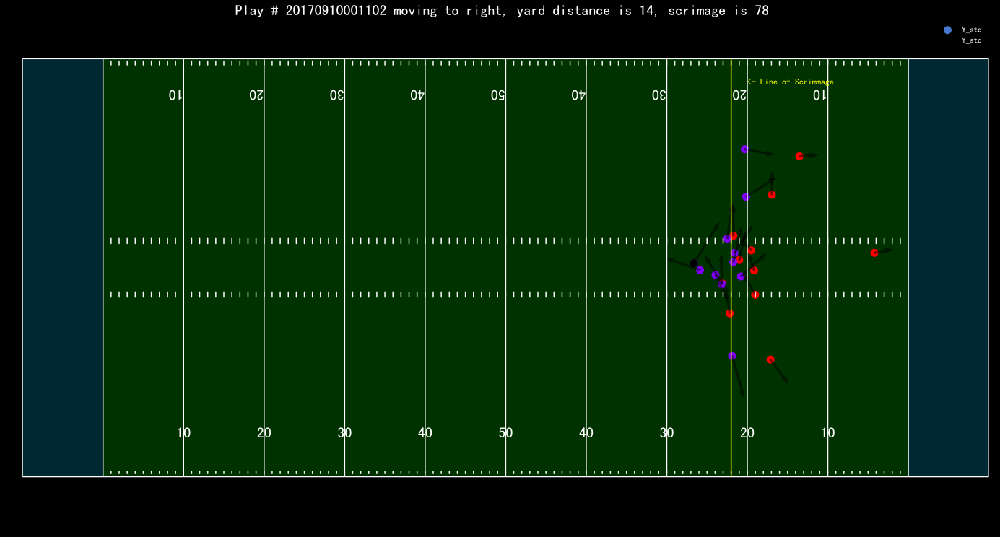

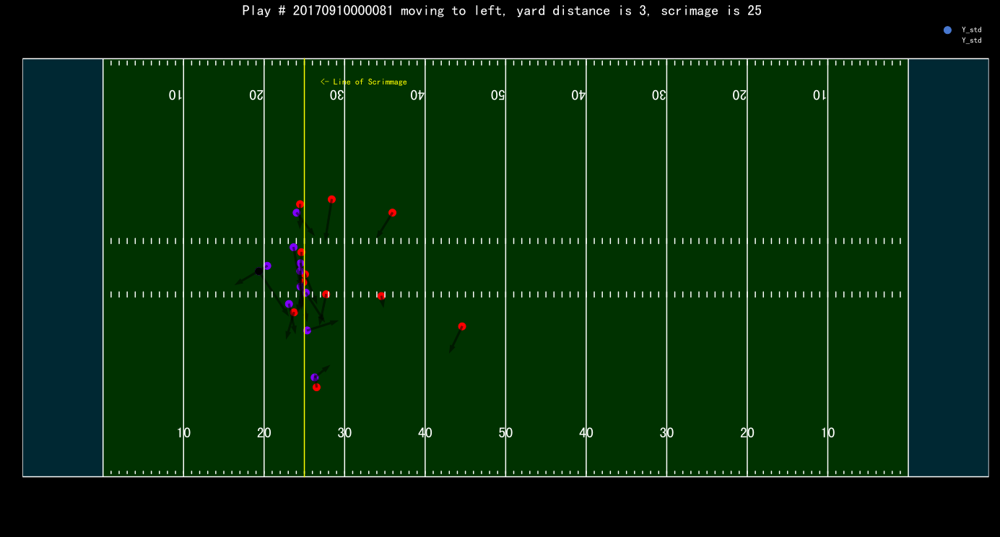

In [68]:
for play_id in [20170910001102, 20170910000081]: 
    show_play_std(play_id)

In [70]:
plt.figure(figsize=(12, 12))
ax = plt.subplot(221, projection='polar')
df = df_train[df_train.ToLeft & df_train.IsBallCarrier]
ax.set_title('Carriers direction with team moving to left')
ax.scatter(df.Dir_rad, df.S, s=1, alpha=0.2)

ax = plt.subplot(222, projection='polar')
df = df_train[~df_train.ToLeft & df_train.IsBallCarrier]
ax.set_title('Carriers direction with team moving to right')
ax.scatter(df.Dir_rad, df.S, s=1, alpha=0.2)

ax = plt.subplot(223, projection='polar')
df = df_train[df_train.IsOnOffense & df_train.IsBallCarrier]
ax.set_title('Carriers direction')
ax.scatter(df.Dir_rad, df.S, s=1, alpha=0.2)

ax = plt.subplot(224, projection='polar')
df = df_train[df_train.IsOnOffense & df_train.IsBallCarrier]
ax.set_title('Carriers standardised direction')
ax.scatter(df.Dir_std, df.S, s=1, alpha=0.2)

<Figure size 864x864 with 0 Axes>

Text(0.5, 1.05, 'Carriers direction with team moving to left')

Text(0.5, 1.05, 'Carriers direction with team moving to right')

Text(0.5, 1.05, 'Carriers direction')

Text(0.5, 1.05, 'Carriers standardised direction')